# Finalist decision (MAD)

# https://vc.ru/data-like

Решением будет CSV-таблица с двумя колонками: answer_id и score. Первая соответствует колонке из stories_reaction_test, она должна быть отсортирована по возрастанию. Вторая — прогноз реакции пользователя на историю.

Реакция может принимать значение от -1 до 1 включительно — чем оно ближе к 1, тем выше вероятность получить лайк. А при значении -1 лучше убрать эту историю долой с глаз пользователя.

# 1. IMPORT

In [1]:
import numpy as np 
import pandas as pd 
import pandas_profiling

# Data processing, metrics and modeling
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold
from sklearn.decomposition import PCA
import collections

# Lgbm
import lightgbm as lgb

# Hyper_opt
from hyperopt import hp
from hyperopt import fmin, tpe, Trials, space_eval, STATUS_OK, STATUS_RUNNING
import hyperopt.pyll
from hyperopt.pyll import scope

# Suppr warning
import warnings
warnings.filterwarnings("ignore")

# Plots
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib import rcParams

# Others
import shap
import datetime
from tqdm import tqdm_notebook
import sys
import pickle
import re
import json

pd.set_option('display.max_columns', 5000)

## Reduce memory usage function

In [2]:
def reduce_mem_usage(df):
    """ iterate through all the columns of a dataframe and modify the data type
        to reduce memory usage.        
    """
    start_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage of dataframe is {:.2f} MB'.format(start_mem))
    
    for col in df.columns:
        col_type = df[col].dtype
        
        if col_type != object:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
        else:
            df[col] = df[col].astype('category')

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))
    
    return df

In [3]:
%%time
folder = 'data/'
customer_train_df = pd.read_csv(folder + 'customer_train.csv')
customer_test_df = pd.read_csv(folder + 'customer_test.csv')
transactions_df = pd.read_csv(folder + 'transactions.csv')
stories_r_train_df = pd.read_csv(folder + 'stories_reaction_train.csv')
stories_r_test_df = pd.read_csv(folder + 'stories_reaction_test.csv')
stories_descr_df = pd.read_csv(folder + 'stories_description.csv')
sample_submission = reduce_mem_usage(pd.read_csv(folder + 'sample_submit.csv'))
merchant_df = pd.read_excel(folder + 'Spravochnik_MCC.xlsx')

Memory usage of dataframe is 2.63 MB
Memory usage after optimization is: 0.98 MB
Decreased by 62.5%
Wall time: 2.52 s


# 2. EDA & Feat engineering

### shape

In [4]:
print('CUSTOMER')
print('Train: ', customer_train_df.shape)
print('Test: ', customer_test_df.shape)
print('TRANSACTIONS')
print('All: ', transactions_df.shape)
print('STORIES_REACTION')
print('Train: ', stories_r_train_df.shape)
print('Test: ', stories_r_test_df.shape)
print('STORIES_DESCRIPTION')
print('All: ', stories_descr_df.shape)
print('SAMPLE')
print('All: ', sample_submission.shape)

CUSTOMER
Train:  (50000, 15)
Test:  (54245, 15)
TRANSACTIONS
All:  (3951115, 6)
STORIES_REACTION
Train:  (473141, 4)
Test:  (172049, 4)
STORIES_DESCRIPTION
All:  (959, 2)
SAMPLE
All:  (172049, 2)


## some func for preprocess

In [5]:
def date_process(df: pd.DataFrame, column: str):
    ''' Get information from date feat '''
    df[column + '_day'] = df[column].apply(lambda ts: int(ts.day))
    df[column + '_day_month_2'] = df[column].apply(lambda ts: (int(ts.month)*100 + int(ts.day))**2)
    df[column + '_day_month_year'] = df[column].apply(lambda ts: (int(ts.year)*10000 + int(ts.month)*100 + int(ts.day)))
    df[column + '_year'] = df[column].apply(lambda ts: int(ts.year))
    df[column + '_month'] = df[column].apply(lambda ts: int(ts.month))
    df[column + '_hour'] = df[column].apply(lambda ts: int(ts.hour))
    df[column + '_weekday'] = df[column].apply(lambda ts: datetime.date(int(ts.year), int(ts.month), int(ts.day)).weekday() + 1)
    return df

# 2.1. customer_df

In [6]:
customer_train_df.head()

,customer_id,product_0,product_1,product_2,product_3,product_4,product_5,product_6,gender_cd,age,marital_status_cd,children_cnt,first_session_dttm,job_position_cd,job_title
0,894436,NaN,NaN,NaN,NaN,NaN,UTL,NaN,M,30.0,MAR,0.0,2018-03-20 09:10:16,1,Неруководящий сотрудник - обсл. Персонал
1,524526,NaN,UTL,NaN,NaN,NaN,UTL,NaN,F,20.0,UNM,0.0,2017-03-29 20:38:45,16,NaN
2,498134,NaN,UTL,NaN,NaN,NaN,NaN,NaN,F,25.0,UNM,0.0,2018-03-12 11:25:06,22,NaN
3,278941,NaN,NaN,UTL,CLS,NaN,UTL,UTL,M,25.0,NaN,NaN,2016-02-21 18:47:51,16,Неруководящий сотрудник - специалист
4,877312,NaN,UTL,NaN,NaN,NaN,NaN,NaN,F,40.0,MAR,0.0,2018-03-07 11:17:02,22,NaN


In [7]:
customer_test_df.head()

,customer_id,product_0,product_1,product_2,product_3,product_4,product_5,product_6,gender_cd,age,marital_status_cd,children_cnt,first_session_dttm,job_position_cd,job_title
0,234305,NaN,NaN,NaN,NaN,NaN,UTL,NaN,F,25.0,NaN,0.0,2015-10-29 09:59:10,22,Менеджер проектов
1,914339,NaN,NaN,NaN,NaN,NaN,UTL,NaN,M,15.0,NaN,0.0,2018-04-09 08:51:54,22,NaN
2,895631,NaN,NaN,NaN,NaN,NaN,UTL,NaN,M,20.0,NaN,0.0,2018-03-22 10:38:33,16,Менеджер по продажам
3,954837,NaN,NaN,NaN,NaN,NaN,UTL,NaN,F,25.0,NaN,0.0,2018-05-09 18:24:32,16,Инженер
4,391590,NaN,UTL,NaN,NaN,NaN,NaN,NaN,M,30.0,UNM,0.0,2016-10-08 05:29:20,20,сборщик мебели


## Products count

In [8]:
%%time
pr = [pr for pr in customer_train_df.columns if 'product_' in pr]
for df_ in (customer_train_df, customer_test_df):
    df_[['CLS_prods', 'OPN_prods', 'UTL_prods']] = df_[pr].apply(lambda x: x.value_counts(), axis=1).fillna(0)[['CLS', 'OPN', 'UTL']]
    df_['all_prods'] = df_[['CLS_prods', 'OPN_prods', 'UTL_prods']].apply(lambda x: x.sum(), axis=1)
    df_[pr].fillna('Unknown', inplace=True)

Wall time: 1min 43s


## Date process

In [9]:
%%time
customer_train_df['first_session_dttm'] = customer_train_df['first_session_dttm'].apply(pd.to_datetime)
customer_test_df['first_session_dttm'] = customer_test_df['first_session_dttm'].apply(pd.to_datetime)
first_session_mean = customer_train_df['first_session_dttm'].mean()
customer_train_df['first_session_dttm'].fillna(first_session_mean, inplace=True)
customer_test_df['first_session_dttm'].fillna(first_session_mean, inplace=True)

Wall time: 9.13 s


In [10]:
%%time
customer_train_df = date_process(customer_train_df, 'first_session_dttm')
customer_test_df = date_process(customer_test_df, 'first_session_dttm')

Wall time: 2.77 s


## Desribe & Profiling

In [11]:
customer_train_df.describe(include='all')

,customer_id,product_0,product_1,product_2,product_3,product_4,product_5,product_6,gender_cd,age,marital_status_cd,children_cnt,first_session_dttm,job_position_cd,job_title,CLS_prods,OPN_prods,UTL_prods,all_prods,first_session_dttm_day,first_session_dttm_day_month_2,first_session_dttm_day_month_year,first_session_dttm_year,first_session_dttm_month,first_session_dttm_hour,first_session_dttm_weekday
count,5.000000e+04,1599,23725,4391,6813,2182,33426,2354,49637,49690.000000,31207,44729.000000,50000,50000.000000,26497,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,5.000000e+04,5.000000e+04,50000.000000,50000.000000,50000.000000,50000.000000
unique,NaN,2,3,3,2,3,3,3,2,NaN,6,NaN,49983,NaN,7414,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,UTL,UTL,UTL,UTL,UTL,UTL,UTL,M,NaN,MAR,NaN,2016-11-10 05:57:12.456047104,NaN,Собственный неофициальный бизнес,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,1582,20412,1895,3725,1384,32078,2081,31803,NaN,14199,NaN,3,NaN,1643,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
first,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2012-06-05 20:14:32,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-21 08:14:41,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,4.872847e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.902093,NaN,0.243936,NaN,16.363140,NaN,0.140180,0.086480,1.263140,1.489800,15.339420,5.064638e+05,2.016457e+07,2016.394580,6.111220,11.756280,3.932320
std,2.818928e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.642922,NaN,0.604332,NaN,6.422185,NaN,0.387263,0.294691,0.667073,0.838779,8.687861,4.564271e+05,1.532069e+04,1.540602,3.376738,4.345515,2.119318
min,1.500000e+01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15.000000,NaN,0.000000,NaN,1.000000,NaN,0.000000,0.000000,0.000000,0.000000,1.000000,1.020100e+04,2.012060e+07,2012.000000,1.000000,0.000000,1.000000
25%,2.428222e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25.000000,NaN,0.000000,NaN,16.000000,NaN,0.000000,0.000000,1.000000,1.000000,8.000000,1.049760e+05,2.016031e+07,2016.000000,3.000000,9.000000,2.000000


In [12]:
customer_test_df.describe(include='all')

,customer_id,product_0,product_1,product_2,product_3,product_4,product_5,product_6,gender_cd,age,marital_status_cd,children_cnt,first_session_dttm,job_position_cd,job_title,CLS_prods,OPN_prods,UTL_prods,all_prods,first_session_dttm_day,first_session_dttm_day_month_2,first_session_dttm_day_month_year,first_session_dttm_year,first_session_dttm_month,first_session_dttm_hour,first_session_dttm_weekday
count,5.424500e+04,1909,26028,5278,7716,2896,37552,2594,53991,54050.000000,34344,48896.000000,54245,54245.000000,29262,54245.000000,54245.000000,54245.000000,54245.000000,54245.000000,5.424500e+04,5.424500e+04,54245.000000,54245.000000,54245.000000,54245.000000
unique,NaN,2,3,3,2,3,3,3,2,NaN,6,NaN,54224,NaN,7896,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,UTL,UTL,UTL,UTL,UTL,UTL,UTL,M,NaN,MAR,NaN,2016-11-10 05:57:12.456047104,NaN,Собственный неофициальный бизнес,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,1889,22475,2514,4238,1872,35957,2267,34578,NaN,15710,NaN,6,NaN,1903,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
first,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2012-06-05 20:14:32,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-21 08:14:41,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,4.909940e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,34.068825,NaN,0.240776,NaN,16.222749,NaN,0.148161,0.087086,1.312785,1.548032,15.333081,5.066293e+05,2.016468e+07,2016.405660,6.118831,11.754171,3.933192
std,2.840845e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.646218,NaN,0.600684,NaN,6.439372,NaN,0.397994,0.295874,0.678148,0.851504,8.688388,4.551639e+05,1.530629e+04,1.539062,3.365063,4.343008,2.119903
min,1.500000e+01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15.000000,NaN,0.000000,NaN,1.000000,NaN,0.000000,0.000000,0.000000,0.000000,1.000000,1.020100e+04,2.012060e+07,2012.000000,1.000000,0.000000,1.000000
25%,2.446190e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25.000000,NaN,0.000000,NaN,16.000000,NaN,0.000000,0.000000,1.000000,1.000000,8.000000,1.056250e+05,2.016032e+07,2016.000000,3.000000,9.000000,2.000000


In [13]:
pandas_profiling.ProfileReport(customer_train_df)

In [14]:
pandas_profiling.ProfileReport(customer_test_df)

## Job title most common

In [15]:
jobs = collections.Counter()
for word in ' '.join(customer_train_df['job_title'].apply(lambda x: str(x).lower()).tolist()).split():
    if len(word) > 2:
        jobs[word] += 1
jobs.most_common(150)

[('nan', 23503),
 ('бизнес', 2667),
 ('собственный', 2638),
 ('специалист', 2612),
 ('менеджер', 2254),
 ('директор', 1784),
 ('неофициальный', 1650),
 ('руководитель', 1231),
 ('инженер', 1131),
 ('отдела', 1047),
 ('официальный', 965),
 ('старший', 820),
 ('сотрудник', 813),
 ('начальник', 797),
 ('неруководящий', 704),
 ('ведущий', 696),
 ('главный', 693),
 ('продажам', 633),
 ('заместитель', 570),
 ('водитель', 568),
 ('бухгалтер', 522),
 ('генеральный', 492),
 ('администратор', 464),
 ('директора', 417),
 ('оператор', 411),
 ('пенсия', 408),
 ('работы', 357),
 ('возрасту/стажу', 346),
 ('продавец', 331),
 ('мастер', 271),
 ('подразделения', 265),
 ('программист', 262),
 ('работе', 252),
 ('продавец-консультант', 234),
 ('продаж', 221),
 ('консультант', 210),
 ('звена', 201),
 ('рабочий', 192),
 ('аналитик', 178),
 ('клиентами', 174),
 ('персонал', 165),
 ('представитель', 162),
 ('помощник', 162),
 ('обсл.', 161),
 ('системный', 161),
 ('начальника', 152),
 ('продавец-кассир', 149

### Some stop words

In [16]:
sw = {'по', 'не', 'ль', 'на', 'для', 'если', 'можно', 'или', 'это', 'чтобы', 'чем', 
      'еще', 'все', 'его', 'вам', 'где', 'без', 'вас', 'когда', 'которые', 'при', 'так',
      'они', 'этого', 'этот', 'вот', 'тех', 'она', 'кто', 'до', 'есть', 'же', 'за', 'во',
      'из', 'их', 'но', 'со', 'уже', 'этом', 'также', 'то', 'под', 'после', 'про', 'от',}

## Job title tf-idf & PCA

In [17]:
vectorizer_jt = TfidfVectorizer(max_features=225, stop_words = sw)
vectorizer_jt.fit(customer_train_df['job_title'].apply(lambda x: str(x).lower()).tolist())

TfidfVectorizer(analyzer='word', binary=False, decode_error='strict',
                dtype=<class 'numpy.float64'>, encoding='utf-8',
                input='content', lowercase=True, max_df=1.0, max_features=225,
                min_df=1, ngram_range=(1, 1), norm='l2', preprocessor=None,
                smooth_idf=True,
                stop_words={'без', 'вам', 'вас', 'во', 'вот', 'все', 'где',
                            'для', 'до', 'его', 'если', 'есть', 'еще', 'же',
                            'за', 'из', 'или', 'их', 'когда', 'которые', 'кто',
                            'ль', 'можно', 'на', 'не', 'но', 'она', 'они', 'от',
                            'по', ...},
                strip_accents=None, sublinear_tf=False,
                token_pattern='(?u)\\b\\w\\w+\\b', tokenizer=None, use_idf=True,
                vocabulary=None)

In [18]:
jt_names = list(map(lambda x: 'jt_' + str(x), vectorizer_jt.get_feature_names()))
customer_train_df[jt_names] = pd.DataFrame(vectorizer_jt.transform(customer_train_df['job_title'].apply(lambda x: str(x).lower()).tolist()).todense())
customer_test_df[jt_names] = pd.DataFrame(vectorizer_jt.transform(customer_test_df['job_title'].apply(lambda x: str(x).lower()).tolist()).todense())
customer_train_df.drop(['job_title', 'first_session_dttm'], axis=1, inplace=True)
customer_test_df.drop(['job_title', 'first_session_dttm'], axis=1, inplace=True)
#customer_train_df.drop(['job_title', ], axis=1, inplace=True)
#customer_test_df.drop(['job_title', ], axis=1, inplace=True)

In [19]:
vectorizer_jt.get_feature_names()[:5]

['nan', 'агент', 'администратор', 'аналитик', 'архитектор']

In [20]:
pca = PCA(n_components=3)
pca.fit(customer_train_df[jt_names])
customer_train_df[['jt_pca1', 'jt_pca2', 'jt_pca3']] = pd.DataFrame(pca.transform(customer_train_df[jt_names]))
customer_test_df[['jt_pca1', 'jt_pca2', 'jt_pca3']] = pd.DataFrame(pca.transform(customer_test_df[jt_names]))

## Let's reduce

In [21]:
%%time
customer_train_df = reduce_mem_usage(customer_train_df)
customer_test_df = reduce_mem_usage(customer_test_df)

Memory usage of dataframe is 96.13 MB
Memory usage after optimization is: 23.65 MB
Decreased by 75.4%
Memory usage of dataframe is 104.29 MB
Memory usage after optimization is: 25.66 MB
Decreased by 75.4%
Wall time: 9.69 s


In [22]:
customer_train_df.head()

,customer_id,product_0,product_1,product_2,product_3,product_4,product_5,product_6,gender_cd,age,marital_status_cd,children_cnt,job_position_cd,CLS_prods,OPN_prods,UTL_prods,all_prods,first_session_dttm_day,first_session_dttm_day_month_2,first_session_dttm_day_month_year,first_session_dttm_year,first_session_dttm_month,first_session_dttm_hour,first_session_dttm_weekday,jt_nan,jt_агент,jt_администратор,jt_аналитик,jt_архитектор,jt_ассистент,jt_бармен,jt_безопасности,jt_бизнес,jt_бизнеса,jt_бригадир,jt_бухгалтер,jt_бухгалтера,jt_веб,jt_ведущий,jt_водитель,jt_военнослужащий,jt_возрасту,jt_воспитатель,jt_врач,jt_высшего,jt_ген,jt_генерального,jt_генеральный,jt_гл,jt_главного,jt_главный,jt_грузоперевозки,jt_грузчик,jt_группы,jt_дежурный,jt_декрет,jt_департамента,jt_дизайнер,jt_директор,jt_директора,jt_диспетчер,jt_домашнего,jt_доцент,jt_зав,jt_заведующая,jt_заведующий,jt_закупкам,jt_закупок,jt_зала,jt_зам,jt_заместитель,jt_звена,jt_инвалидности,jt_индивидуальный,jt_инженер,jt_инжинер,jt_инспектор,jt_инструктор,jt_интернет,jt_ип,jt_исполнительный,jt_ит,jt_кадров,jt_кассир,jt_категории,jt_кладовщик,jt_клиентами,jt_командир,jt_коммерческий,jt_комплектовщик,jt_конструктор,jt_консультант,jt_контролер,jt_координатор,jt_кредитный,jt_курьер,jt_кц,jt_лаборант,jt_логист,jt_логистике,jt_логистики,jt_магазина,jt_магазином,jt_маляр,jt_маркетинга,jt_маркетингу,jt_маркетолог,jt_мастер,jt_машинист,jt_мебели,jt_медицинская,jt_медсестра,jt_менеджер,jt_механик,jt_младший,jt_монтажник,jt_направления,jt_научный,jt_нач,jt_начальник,jt_начальника,jt_недвижимости,jt_неофициальный,jt_неруководящий,jt_низшего,jt_обеспечения,jt_оборудования,jt_обсл,jt_обслуживанию,jt_ово,jt_оператор,jt_операционист,jt_организации,jt_отдела,jt_отделения,jt_офис,jt_офиса,jt_официальный,jt_официант,jt_охранник,jt_охраны,jt_парикмахер,jt_педагог,jt_пенсионер,jt_пенсия,jt_персонал,jt_персонала,jt_персоналу,jt_пк,jt_повар,jt_поддержки,jt_подразделения,jt_помощник,jt_предприниматель,jt_представитель,jt_преподаватель,jt_приемщик,jt_програмист,jt_программист,jt_продавец,jt_продаж,jt_продажам,jt_проекта,jt_проектировщик,jt_проектов,jt_производства,jt_прораб,jt_пто,jt_работ,jt_работает,jt_работаю,jt_работе,jt_работник,jt_работы,jt_рабочий,jt_развитию,jt_разработки,jt_разработчик,jt_разряда,jt_региональный,jt_редактор,jt_рекламе,jt_ремонт,jt_ремонтник,jt_ремонту,jt_рук,jt_руководитель,jt_руководителя,jt_сборщик,jt_сварщик,jt_связи,jt_секретарь,jt_сектора,jt_сервиса,jt_сервисный,jt_сестра,jt_систем,jt_системный,jt_склада,jt_складом,jt_слесарь,jt_службы,jt_смены,jt_снабжения,jt_собственный,jt_сотрудник,jt_специалист,jt_среднего,jt_стажу,jt_старший,jt_стилист,jt_стоматолог,jt_студент,jt_супервайзер,jt_такси,jt_тестированию,jt_тестировщик,jt_техник,jt_технический,jt_технической,jt_технолог,jt_товаровед,jt_торговля,jt_торгового,jt_торговый,jt_тренер,jt_уборщица,jt_управления,jt_управляющая,jt_управляющий,jt_участка,jt_учитель,jt_учредитель,jt_фельдшер,jt_филиала,jt_финансовый,jt_центра,jt_цеха,jt_шеф,jt_экономист,jt_экспедитор,jt_эксперт,jt_электрик,jt_электрогазосварщик,jt_электромеханик,jt_электромонтажник,jt_электромонтер,jt_юрисконсульт,jt_юрист,jt_pca1,jt_pca2,jt_pca3
0,894436,NaN,NaN,NaN,NaN,NaN,UTL,NaN,M,30.0,MAR,0.0,1,0.0,0.0,1.0,1.0,20,102400,20180320,2018,3,9,2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.438232,0.0,0.0,0.0,0.560059,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.558594,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

# 2.2. transactions_df

In [23]:
len(transactions_df['customer_id'].unique())

46948

In [24]:
transactions_df.head()

,customer_id,transaction_month,transaction_day,transaction_amt,merchant_id,merchant_mcc
0,855115,7,3,1500,4554547,5411
1,997036,6,6,0,1657528,5411
2,398237,5,24,2500,26375569,5813
3,997036,6,2,0,16304402,5411
4,291636,7,25,0,1259505,5411


## Some analytics for transactions

In [25]:
pd.DataFrame(transactions_df.groupby(['customer_id', 'merchant_mcc', 'transaction_month', 'transaction_day']).agg({'transaction_amt': ['count', 'sum', 'min', 'max', 'mean', np.median]}))

transaction_amt  \
                                                                     count   
customer_id merchant_mcc transaction_month transaction_day                   
15          3011         6                 29                            1   
                         7                 23                            1   
            4784         7                 9                             1   
            4814         5                 27                            2   
                         6                 17                            1   
...                                                                    ...   
1103495     5945         7                 20                            1   
            5977         5                 26                            1   
                         7                 6                             1   
            6300         5                 27                            1   
            7538         7                 14                            1   

                                                                            \
                                                               sum     min   
customer_id merchant_mcc transaction_month transaction_day                   
15          3011         6                 29               835500  835500   
                         7                 23               375000  375000   
            4784         7                 9                 15000   15000   
            4814         5                 27                 1500     500   
                         6                 17                  500     500   
...                                                            ...     ...   
1103495     5945         7                 20                 2000    2000   
            5977         5                 26                 4000    4000   
                         7                 6                  2500    2500   
            6300         5                 27                31500   31500   
            7538         7                 14                  500     500   

                                                                              \
                                                               max      mean   
customer_id merchant_mcc transaction_month transaction_day                     
15          3011         6                 29               835500  835500.0   
                         7                 23               375000  375000.0   
            4784         7                 9                 15000   15000.0   
            4814         5                 27                 1000     750.0   
                         6                 17                  500     500.0   
...                                                            ...       ...   
1103495     5945         7                 20                 2000    2000.0   
            5977         5                 26                 4000    4000.0   
                         7                 6                  2500    2500.0   
            6300         5                 27                31500   31500.0   
            7538         7                 14                  500     500.0   

                                                                    
                                                            median  
customer_id merchant_mcc transaction_month transaction_day          
15          3011         6                 29               835500  
                         7                 23               375000  
            4784         7                 9                 15000  
            4814         5                 27                  750  
                         6                 17                  500  
...                                                            ...  
1103495     5945         7                 20                 2000  
            5977         5                 26                 

In [26]:
merchant_df.head()

,Код МСС,Тип торговой точки,MCC Группа,Название торговой точки (латиница),Название торговой точки (кириллица),Адрес,№ кассы,Страна,Город,Дата внесения в базу,Примечание
0,1,NaN,Retail Purchase,NaN,NaN,NaN,NaN,NaN,NaN,2012-10-08,NaN
1,2,NaN,Retail Purchase,NaN,NaN,NaN,NaN,NaN,NaN,2012-10-08,NaN
2,3,NaN,Retail Purchase,NaN,NaN,NaN,NaN,NaN,NaN,2012-10-08,NaN
3,4,NaN,Retail Purchase,NaN,NaN,NaN,NaN,NaN,NaN,2012-10-08,NaN
4,5,NaN,Retail Purchase,NaN,NaN,NaN,NaN,NaN,NaN,2012-10-08,NaN


## Join some merchant groups

In [27]:
mcc_dict = dict(zip(merchant_df['Код МСС'], merchant_df['MCC Группа'].apply(lambda g: str(g).replace(' ', '_'))))
transactions_df['merchant_group'] = transactions_df['merchant_mcc'].map(mcc_dict)

In [28]:
transactions_df.head()

,customer_id,transaction_month,transaction_day,transaction_amt,merchant_id,merchant_mcc,merchant_group
0,855115,7,3,1500,4554547,5411,Food_Stores
1,997036,6,6,0,1657528,5411,Food_Stores
2,398237,5,24,2500,26375569,5813,Restaurant
3,997036,6,2,0,16304402,5411,Food_Stores
4,291636,7,25,0,1259505,5411,Food_Stores


## Group by merchant_group

In [29]:
tr_tmp = pd.DataFrame(pd.pivot_table(transactions_df, values=['transaction_amt'], index=['customer_id'], columns=['merchant_group'], aggfunc={'transaction_amt': ['max', 'min', 'count', np.mean, np.median, np.std, np.sum]}, fill_value=0))
tr_tmp.columns = list(map(lambda c: '_'.join(list(map(lambda cc: str(cc), c))), tr_tmp.columns.tolist()))

In [30]:
all_tr_tmp = pd.DataFrame(pd.pivot_table(transactions_df, values=['transaction_amt'], index=['customer_id'], aggfunc={'transaction_amt': ['max', 'count', np.mean, np.median, np.std, np.sum]}, fill_value=0))
all_tr_tmp.columns = list(map(lambda c: '_'.join(list(map(lambda cc: str(cc), c))), all_tr_tmp.columns.tolist()))
tr_tmp = tr_tmp.merge(all_tr_tmp, how='left', left_on=['customer_id'], right_on=['customer_id'])

In [31]:
for c in tr_tmp.columns:
    if '_sum' in c and c != 'transaction_amt_sum':
        tr_tmp[c.replace('transaction_amt', 'percent')] = tr_tmp[c] / tr_tmp['transaction_amt_sum']
    if '_count' in c and c != 'transaction_amt_count':
        tr_tmp[c.replace('transaction_amt', 'percent')] = tr_tmp[c] / tr_tmp['transaction_amt_count']

In [32]:
tr_tmp.head()

,transaction_amt_count_Financial_Institutions,transaction_amt_count_Food_Stores,transaction_amt_count_Hotel,transaction_amt_count_Jewelry,transaction_amt_count_Mail_Phone,transaction_amt_count_Restaurant,transaction_amt_count_Retail_Purchase,transaction_amt_count_Transportation,transaction_amt_count_Unique,transaction_amt_count_Vehicle_Rental,transaction_amt_max_Financial_Institutions,transaction_amt_max_Food_Stores,transaction_amt_max_Hotel,transaction_amt_max_Jewelry,transaction_amt_max_Mail_Phone,transaction_amt_max_Restaurant,transaction_amt_max_Retail_Purchase,transaction_amt_max_Transportation,transaction_amt_max_Unique,transaction_amt_max_Vehicle_Rental,transaction_amt_mean_Financial_Institutions,transaction_amt_mean_Food_Stores,transaction_amt_mean_Hotel,transaction_amt_mean_Jewelry,transaction_amt_mean_Mail_Phone,transaction_amt_mean_Restaurant,transaction_amt_mean_Retail_Purchase,transaction_amt_mean_Transportation,transaction_amt_mean_Unique,transaction_amt_mean_Vehicle_Rental,transaction_amt_median_Financial_Institutions,transaction_amt_median_Food_Stores,transaction_amt_median_Hotel,transaction_amt_median_Jewelry,transaction_amt_median_Mail_Phone,transaction_amt_median_Restaurant,transaction_amt_median_Retail_Purchase,transaction_amt_median_Transportation,transaction_amt_median_Unique,transaction_amt_median_Vehicle_Rental,transaction_amt_min_Financial_Institutions,transaction_amt_min_Food_Stores,transaction_amt_min_Hotel,transaction_amt_min_Jewelry,transaction_amt_min_Mail_Phone,transaction_amt_min_Restaurant,transaction_amt_min_Retail_Purchase,transaction_amt_min_Transportation,transaction_amt_min_Unique,transaction_amt_min_Vehicle_Rental,transaction_amt_std_Financial_Institutions,transaction_amt_std_Food_Stores,transaction_amt_std_Hotel,transaction_amt_std_Jewelry,transaction_amt_std_Mail_Phone,transaction_amt_std_Restaurant,transaction_amt_std_Retail_Purchase,transaction_amt_std_Transportation,transaction_amt_std_Unique,transaction_amt_std_Vehicle_Rental,transaction_amt_sum_Financial_Institutions,transaction_amt_sum_Food_Stores,transaction_amt_sum_Hotel,transaction_amt_sum_Jewelry,transaction_amt_sum_Mail_Phone,transaction_amt_sum_Restaurant,transaction_amt_sum_Retail_Purchase,transaction_amt_sum_Transportation,transaction_amt_sum_Unique,transaction_amt_sum_Vehicle_Rental,transaction_amt_count,transaction_amt_max,transaction_amt_mean,transaction_amt_median,transaction_amt_std,transaction_amt_sum,percent_count_Financial_Institutions,percent_count_Food_Stores,percent_count_Hotel,percent_count_Jewelry,percent_count_Mail_Phone,percent_count_Restaurant,percent_count_Retail_Purchase,percent_count_Transportation,percent_count_Unique,percent_count_Vehicle_Rental,percent_sum_Financial_Institutions,percent_sum_Food_Stores,percent_sum_Hotel,percent_sum_Jewelry,percent_sum_Mail_Phone,percent_sum_Restaurant,percent_sum_Retail_Purchase,percent_sum_Transportation,percent_sum_Unique,percent_sum_Vehicle_Rental
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
15,0,35,2,1,4,10,46,2,0,0,0,44000,269500,3500,1000,48500,81500,835500,0,0,0,4800.000000,172250.000000,3500.0,625.000000,7800.000000,9000.000000,605250.000000,0.0,0.0,0,2500,172250,3500,500,2750,2500,605250,0,0,0,0,75000,3500,500,1000,0,375000,0,0,0,7984.543893,137532.268941,0.0,250.000000,14543.421575,15745.898937,325622.672736,0.0,0.0,0,168000,344500,3500,2500,78000,414000,1210500,0,0,100,835500,22210.000000,2500,94708.222313,2221000,0.0,0.350000,0.020000,0.01,0.040000,0.100000,0.460000,0.020000,0.0,0.000000,0.0,0.075642,0.155110,0.001576,0.001126,0.035119,0.186403,0.545025,0.0,0.000000
73,0,55,5,0,17,19,199,9,0,1,0,9500,84500,0,1000,67500,108000,103500,0,24000,0,1236.363636,33000.000000,0.0,823.529412,11421.052632,2105.527638,26944.444444,0.0,24000.0,0,1000,25500,0,1000,1000,500,16000,0,24000,0,0,13500,0,0,0,0,500,0,24000,0,1737.000782,29389.624019,0.0,303.169531,21082.683230,8759.636517,32135.887692,0.0,0.0,0,680

## Reduce it!

In [33]:
%%time
tr_tmp = reduce_mem_usage(tr_tmp)

Memory usage of dataframe is 34.69 MB
Memory usage after optimization is: 14.04 MB
Decreased by 59.5%
Wall time: 371 ms


### profiling...

In [34]:
pandas_profiling.ProfileReport(tr_tmp)

# More analytics for transactions

## Group by transaction_day, transaction_month & PCA it!

In [35]:
trn_pca = pd.DataFrame(pd.pivot_table(transactions_df, values=['transaction_amt'], index=['customer_id'], 
                                      columns=['transaction_day', 'transaction_month'], 
                                      aggfunc={'transaction_amt': ['count']}, fill_value=0)).reset_index()
pca1 = PCA(n_components=9)
pca1.fit(trn_pca)
trn_pca[['tran_pca1', 'tran_pca2', 'tran_pca3', 'tran_pca4', 'tran_pca5', 'tran_pca6', 'tran_pca7', 'tran_pca8', 'tran_pca9']] = pd.DataFrame(pca1.transform(trn_pca), columns=['tran_pca1', 'tran_pca2', 'tran_pca3', 'tran_pca4', 'tran_pca5', 'tran_pca6', 'tran_pca7', 'tran_pca8', 'tran_pca9'])
trn_pca = trn_pca[['customer_id', 'tran_pca1', 'tran_pca2', 'tran_pca3', 'tran_pca4', 'tran_pca5', 'tran_pca6', 'tran_pca7', 'tran_pca8', 'tran_pca9']]
trn_pca.columns = ['customer_id', 'tran_pca1', 'tran_pca2', 'tran_pca3', 'tran_pca4', 'tran_pca5', 'tran_pca6', 'tran_pca7', 'tran_pca8', 'tran_pca9']
tr_tmp = tr_tmp.merge(trn_pca, how='left', left_on=['customer_id'], right_on=['customer_id'])

## Group by merchant_mcc & PCA it!

In [36]:
trn_pca = pd.DataFrame(pd.pivot_table(transactions_df, values=['transaction_amt'], index=['customer_id'], 
                                      columns=['merchant_mcc'], 
                                      aggfunc={'transaction_amt': ['count']}, fill_value=0)).reset_index()
pca1 = PCA(n_components=5)
pca1.fit(trn_pca)
trn_pca[['tran_mcc_pca1', 'tran_mcc_pca2', 'tran_mcc_pca3', 'tran_mcc_pca4', 'tran_mcc_pca5']] = pd.DataFrame(pca1.transform(trn_pca), columns=['tran_mcc_pca1', 'tran_mcc_pca2', 'tran_mcc_pca3', 'tran_mcc_pca4', 'tran_mcc_pca5'])
trn_pca = trn_pca[['customer_id', 'tran_mcc_pca1', 'tran_mcc_pca2', 'tran_mcc_pca3', 'tran_mcc_pca4', 'tran_mcc_pca5']]
trn_pca.columns = ['customer_id', 'tran_mcc_pca1', 'tran_mcc_pca2', 'tran_mcc_pca3', 'tran_mcc_pca4', 'tran_mcc_pca5']
tr_tmp = tr_tmp.merge(trn_pca, how='left', left_on=['customer_id'], right_on=['customer_id'])

### Check it

In [37]:
tr_tmp

,customer_id,transaction_amt_count_Financial_Institutions,transaction_amt_count_Food_Stores,transaction_amt_count_Hotel,transaction_amt_count_Jewelry,transaction_amt_count_Mail_Phone,transaction_amt_count_Restaurant,transaction_amt_count_Retail_Purchase,transaction_amt_count_Transportation,transaction_amt_count_Unique,transaction_amt_count_Vehicle_Rental,transaction_amt_max_Financial_Institutions,transaction_amt_max_Food_Stores,transaction_amt_max_Hotel,transaction_amt_max_Jewelry,transaction_amt_max_Mail_Phone,transaction_amt_max_Restaurant,transaction_amt_max_Retail_Purchase,transaction_amt_max_Transportation,transaction_amt_max_Unique,transaction_amt_max_Vehicle_Rental,transaction_amt_mean_Financial_Institutions,transaction_amt_mean_Food_Stores,transaction_amt_mean_Hotel,transaction_amt_mean_Jewelry,transaction_amt_mean_Mail_Phone,transaction_amt_mean_Restaurant,transaction_amt_mean_Retail_Purchase,transaction_amt_mean_Transportation,transaction_amt_mean_Unique,transaction_amt_mean_Vehicle_Rental,transaction_amt_median_Financial_Institutions,transaction_amt_median_Food_Stores,transaction_amt_median_Hotel,transaction_amt_median_Jewelry,transaction_amt_median_Mail_Phone,transaction_amt_median_Restaurant,transaction_amt_median_Retail_Purchase,transaction_amt_median_Transportation,transaction_amt_median_Unique,transaction_amt_median_Vehicle_Rental,transaction_amt_min_Financial_Institutions,transaction_amt_min_Food_Stores,transaction_amt_min_Hotel,transaction_amt_min_Jewelry,transaction_amt_min_Mail_Phone,transaction_amt_min_Restaurant,transaction_amt_min_Retail_Purchase,transaction_amt_min_Transportation,transaction_amt_min_Unique,transaction_amt_min_Vehicle_Rental,transaction_amt_std_Financial_Institutions,transaction_amt_std_Food_Stores,transaction_amt_std_Hotel,transaction_amt_std_Jewelry,transaction_amt_std_Mail_Phone,transaction_amt_std_Restaurant,transaction_amt_std_Retail_Purchase,transaction_amt_std_Transportation,transaction_amt_std_Unique,transaction_amt_std_Vehicle_Rental,transaction_amt_sum_Financial_Institutions,transaction_amt_sum_Food_Stores,transaction_amt_sum_Hotel,transaction_amt_sum_Jewelry,transaction_amt_sum_Mail_Phone,transaction_amt_sum_Restaurant,transaction_amt_sum_Retail_Purchase,transaction_amt_sum_Transportation,transaction_amt_sum_Unique,transaction_amt_sum_Vehicle_Rental,transaction_amt_count,transaction_amt_max,transaction_amt_mean,transaction_amt_median,transaction_amt_std,transaction_amt_sum,percent_count_Financial_Institutions,percent_count_Food_Stores,percent_count_Hotel,percent_count_Jewelry,percent_count_Mail_Phone,percent_count_Restaurant,percent_count_Retail_Purchase,percent_count_Transportation,percent_count_Unique,percent_count_Vehicle_Rental,percent_sum_Financial_Institutions,percent_sum_Food_Stores,percent_sum_Hotel,percent_sum_Jewelry,percent_sum_Mail_Phone,percent_sum_Restaurant,percent_sum_Retail_Purchase,percent_sum_Transportation,percent_sum_Unique,percent_sum_Vehicle_Rental,tran_pca1,tran_pca2,tran_pca3,tran_pca4,tran_pca5,tran_pca6,tran_pca7,tran_pca8,tran_pca9,tran_mcc_pca1,tran_mcc_pca2,tran_mcc_pca3,tran_mcc_pca4,tran_mcc_pca5
0,15,0,35,2,1,4,10,46,2,0,0,0,44000,269500,3500,1000,48500,81500,835500,0,0,0,4800.000000,172250.000000,3500.0,625.000000,7800.000000,9000.000000,605250.000000,0.0,0.0,0,2500,172250,3500,500,2750,2500,605250,0,0,0,0,75000,3500,500,1000,0,375000,0,0,0,7984.543945,137532.265625,0.0,250.000000,14543.421875,15745.899414,325622.687500,0.0,0.0,0,168000,344500,3500,2500,78000,414000,1210500,0,0,100,835500,22210.000000,2500,94708.218750,2221000,0.0,0.350098,0.020004,0.010002,0.040009,0.099976,0.459961,0.020004,0.0,0.000000,0.0,0.075623,0.155151,0.001575,0.001125,0.035126,0.186401,0.544922,0.0,0.000000,-487316.696560,-0.600488,-1.216715,-0.412515,2.794329,-1.965317,0.230588,0.216295,-0.552470,-487316.696469,-8.317747,-10.728591,0.427892,2.200313
1,73,0,55,5,0,17,19,199,9,0,1,0,9500,84500,0,1000,67500,108000,103500,0,24000,0,1236.363647,33000.000000,0.0,823.52941

### Merge it

In [38]:
%%time
customer_train_df = customer_train_df.merge(tr_tmp, how='left', left_on=['customer_id'], right_on=['customer_id'])
customer_test_df = customer_test_df.merge(tr_tmp, how='left', left_on=['customer_id'], right_on=['customer_id'])

Wall time: 453 ms


In [39]:
customer_train_df.head()

,customer_id,product_0,product_1,product_2,product_3,product_4,product_5,product_6,gender_cd,age,marital_status_cd,children_cnt,job_position_cd,CLS_prods,OPN_prods,UTL_prods,all_prods,first_session_dttm_day,first_session_dttm_day_month_2,first_session_dttm_day_month_year,first_session_dttm_year,first_session_dttm_month,first_session_dttm_hour,first_session_dttm_weekday,jt_nan,jt_агент,jt_администратор,jt_аналитик,jt_архитектор,jt_ассистент,jt_бармен,jt_безопасности,jt_бизнес,jt_бизнеса,jt_бригадир,jt_бухгалтер,jt_бухгалтера,jt_веб,jt_ведущий,jt_водитель,jt_военнослужащий,jt_возрасту,jt_воспитатель,jt_врач,jt_высшего,jt_ген,jt_генерального,jt_генеральный,jt_гл,jt_главного,jt_главный,jt_грузоперевозки,jt_грузчик,jt_группы,jt_дежурный,jt_декрет,jt_департамента,jt_дизайнер,jt_директор,jt_директора,jt_диспетчер,jt_домашнего,jt_доцент,jt_зав,jt_заведующая,jt_заведующий,jt_закупкам,jt_закупок,jt_зала,jt_зам,jt_заместитель,jt_звена,jt_инвалидности,jt_индивидуальный,jt_инженер,jt_инжинер,jt_инспектор,jt_инструктор,jt_интернет,jt_ип,jt_исполнительный,jt_ит,jt_кадров,jt_кассир,jt_категории,jt_кладовщик,jt_клиентами,jt_командир,jt_коммерческий,jt_комплектовщик,jt_конструктор,jt_консультант,jt_контролер,jt_координатор,jt_кредитный,jt_курьер,jt_кц,jt_лаборант,jt_логист,jt_логистике,jt_логистики,jt_магазина,jt_магазином,jt_маляр,jt_маркетинга,jt_маркетингу,jt_маркетолог,jt_мастер,jt_машинист,jt_мебели,jt_медицинская,jt_медсестра,jt_менеджер,jt_механик,jt_младший,jt_монтажник,jt_направления,jt_научный,jt_нач,jt_начальник,jt_начальника,jt_недвижимости,jt_неофициальный,jt_неруководящий,jt_низшего,jt_обеспечения,jt_оборудования,jt_обсл,jt_обслуживанию,jt_ово,jt_оператор,jt_операционист,jt_организации,jt_отдела,jt_отделения,jt_офис,jt_офиса,jt_официальный,jt_официант,jt_охранник,jt_охраны,jt_парикмахер,jt_педагог,jt_пенсионер,jt_пенсия,jt_персонал,jt_персонала,jt_персоналу,jt_пк,jt_повар,jt_поддержки,jt_подразделения,jt_помощник,jt_предприниматель,jt_представитель,jt_преподаватель,jt_приемщик,jt_програмист,jt_программист,jt_продавец,jt_продаж,jt_продажам,jt_проекта,jt_проектировщик,jt_проектов,jt_производства,jt_прораб,jt_пто,jt_работ,jt_работает,jt_работаю,jt_работе,jt_работник,jt_работы,jt_рабочий,jt_развитию,jt_разработки,jt_разработчик,jt_разряда,jt_региональный,jt_редактор,jt_рекламе,jt_ремонт,jt_ремонтник,jt_ремонту,jt_рук,jt_руководитель,jt_руководителя,jt_сборщик,jt_сварщик,jt_связи,jt_секретарь,jt_сектора,jt_сервиса,jt_сервисный,jt_сестра,jt_систем,jt_системный,jt_склада,jt_складом,jt_слесарь,jt_службы,jt_смены,jt_снабжения,jt_собственный,jt_сотрудник,jt_специалист,jt_среднего,jt_стажу,jt_старший,jt_стилист,jt_стоматолог,jt_студент,jt_супервайзер,jt_такси,jt_тестированию,jt_тестировщик,jt_техник,jt_технический,jt_технической,jt_технолог,jt_товаровед,jt_торговля,jt_торгового,jt_торговый,jt_тренер,jt_уборщица,jt_управления,jt_управляющая,jt_управляющий,jt_участка,jt_учитель,jt_учредитель,jt_фельдшер,jt_филиала,jt_финансовый,jt_центра,jt_цеха,jt_шеф,jt_экономист,jt_экспедитор,jt_эксперт,jt_электрик,jt_электрогазосварщик,jt_электромеханик,jt_электромонтажник,jt_электромонтер,jt_юрисконсульт,jt_юрист,jt_pca1,jt_pca2,jt_pca3,transaction_amt_count_Financial_Institutions,transaction_amt_count_Food_Stores,transaction_amt_count_Hotel,transaction_amt_count_Jewelry,transaction_amt_count_Mail_Phone,transaction_amt_count_Restaurant,transaction_amt_count_Retail_Purchase,transaction_amt_count_Transportation,transaction_amt_count_Unique,transaction_amt_count_Vehicle_Rental,transaction_amt_max_Financial_Institutions,transaction_amt_max_Food_Stores,transaction_amt_max_Hotel,transaction_amt_max_Jewelry,transaction_amt_max_Mail_Phone,transaction_amt_max_Restaurant,transaction_amt_max_Retail_Purchase,transaction_amt_max_Transportation,transaction_amt_max_Unique,transaction_amt_max_Vehicle_Rental,transaction_amt_mean_Financial_Institutions,transaction_amt_mean_Food_Stores,transaction_amt_mean_Hotel,transaction_amt_mean_Jewelry,transaction_amt_mean_Mail_Phone,t

In [40]:
customer_test_df.head()

,customer_id,product_0,product_1,product_2,product_3,product_4,product_5,product_6,gender_cd,age,marital_status_cd,children_cnt,job_position_cd,CLS_prods,OPN_prods,UTL_prods,all_prods,first_session_dttm_day,first_session_dttm_day_month_2,first_session_dttm_day_month_year,first_session_dttm_year,first_session_dttm_month,first_session_dttm_hour,first_session_dttm_weekday,jt_nan,jt_агент,jt_администратор,jt_аналитик,jt_архитектор,jt_ассистент,jt_бармен,jt_безопасности,jt_бизнес,jt_бизнеса,jt_бригадир,jt_бухгалтер,jt_бухгалтера,jt_веб,jt_ведущий,jt_водитель,jt_военнослужащий,jt_возрасту,jt_воспитатель,jt_врач,jt_высшего,jt_ген,jt_генерального,jt_генеральный,jt_гл,jt_главного,jt_главный,jt_грузоперевозки,jt_грузчик,jt_группы,jt_дежурный,jt_декрет,jt_департамента,jt_дизайнер,jt_директор,jt_директора,jt_диспетчер,jt_домашнего,jt_доцент,jt_зав,jt_заведующая,jt_заведующий,jt_закупкам,jt_закупок,jt_зала,jt_зам,jt_заместитель,jt_звена,jt_инвалидности,jt_индивидуальный,jt_инженер,jt_инжинер,jt_инспектор,jt_инструктор,jt_интернет,jt_ип,jt_исполнительный,jt_ит,jt_кадров,jt_кассир,jt_категории,jt_кладовщик,jt_клиентами,jt_командир,jt_коммерческий,jt_комплектовщик,jt_конструктор,jt_консультант,jt_контролер,jt_координатор,jt_кредитный,jt_курьер,jt_кц,jt_лаборант,jt_логист,jt_логистике,jt_логистики,jt_магазина,jt_магазином,jt_маляр,jt_маркетинга,jt_маркетингу,jt_маркетолог,jt_мастер,jt_машинист,jt_мебели,jt_медицинская,jt_медсестра,jt_менеджер,jt_механик,jt_младший,jt_монтажник,jt_направления,jt_научный,jt_нач,jt_начальник,jt_начальника,jt_недвижимости,jt_неофициальный,jt_неруководящий,jt_низшего,jt_обеспечения,jt_оборудования,jt_обсл,jt_обслуживанию,jt_ово,jt_оператор,jt_операционист,jt_организации,jt_отдела,jt_отделения,jt_офис,jt_офиса,jt_официальный,jt_официант,jt_охранник,jt_охраны,jt_парикмахер,jt_педагог,jt_пенсионер,jt_пенсия,jt_персонал,jt_персонала,jt_персоналу,jt_пк,jt_повар,jt_поддержки,jt_подразделения,jt_помощник,jt_предприниматель,jt_представитель,jt_преподаватель,jt_приемщик,jt_програмист,jt_программист,jt_продавец,jt_продаж,jt_продажам,jt_проекта,jt_проектировщик,jt_проектов,jt_производства,jt_прораб,jt_пто,jt_работ,jt_работает,jt_работаю,jt_работе,jt_работник,jt_работы,jt_рабочий,jt_развитию,jt_разработки,jt_разработчик,jt_разряда,jt_региональный,jt_редактор,jt_рекламе,jt_ремонт,jt_ремонтник,jt_ремонту,jt_рук,jt_руководитель,jt_руководителя,jt_сборщик,jt_сварщик,jt_связи,jt_секретарь,jt_сектора,jt_сервиса,jt_сервисный,jt_сестра,jt_систем,jt_системный,jt_склада,jt_складом,jt_слесарь,jt_службы,jt_смены,jt_снабжения,jt_собственный,jt_сотрудник,jt_специалист,jt_среднего,jt_стажу,jt_старший,jt_стилист,jt_стоматолог,jt_студент,jt_супервайзер,jt_такси,jt_тестированию,jt_тестировщик,jt_техник,jt_технический,jt_технической,jt_технолог,jt_товаровед,jt_торговля,jt_торгового,jt_торговый,jt_тренер,jt_уборщица,jt_управления,jt_управляющая,jt_управляющий,jt_участка,jt_учитель,jt_учредитель,jt_фельдшер,jt_филиала,jt_финансовый,jt_центра,jt_цеха,jt_шеф,jt_экономист,jt_экспедитор,jt_эксперт,jt_электрик,jt_электрогазосварщик,jt_электромеханик,jt_электромонтажник,jt_электромонтер,jt_юрисконсульт,jt_юрист,jt_pca1,jt_pca2,jt_pca3,transaction_amt_count_Financial_Institutions,transaction_amt_count_Food_Stores,transaction_amt_count_Hotel,transaction_amt_count_Jewelry,transaction_amt_count_Mail_Phone,transaction_amt_count_Restaurant,transaction_amt_count_Retail_Purchase,transaction_amt_count_Transportation,transaction_amt_count_Unique,transaction_amt_count_Vehicle_Rental,transaction_amt_max_Financial_Institutions,transaction_amt_max_Food_Stores,transaction_amt_max_Hotel,transaction_amt_max_Jewelry,transaction_amt_max_Mail_Phone,transaction_amt_max_Restaurant,transaction_amt_max_Retail_Purchase,transaction_amt_max_Transportation,transaction_amt_max_Unique,transaction_amt_max_Vehicle_Rental,transaction_amt_mean_Financial_Institutions,transaction_amt_mean_Food_Stores,transaction_amt_mean_Hotel,transaction_amt_mean_Jewelry,transaction_amt_mean_Mail_Phone,t

# 2.3. stories_descr_df

In [41]:
stories_descr_df.head()

,story_id,story_json
0,127,"{""guid"":""770a5bae-0e3f-4a6b-b924-bd87bd51a038""..."
1,254,"{""guid"":""64f4c9ef-647b-4e04-b4d4-02297e939388""..."
2,865,"{""guid"":""3482206b-d223-4aec-92ba-0150055cd68a""..."
3,1491,"{""guid"":""5f4a9215-01de-4777-b70f-a18899db8f1c""..."
4,598,"{""guid"":""ed8754bd-67be-4fa1-9289-5508d96f1fa4""..."


## JSON parsing

In [42]:
stories_descr_tmp = stories_descr_df.copy()
stories_descr_tmp[['guid', 'type', 'description', 'properties', 'content']] = stories_descr_tmp['story_json'].apply(lambda s: pd.Series(json.loads(str(s).replace('\"\"', '\"').replace('\\\\', '\\').replace('\\"торг уместен\\', 'торг уместен'))))
stories_descr_tmp.head()

,story_id,story_json,guid,type,description,properties,content
0,127,"{""guid"":""770a5bae-0e3f-4a6b-b924-bd87bd51a038""...",770a5bae-0e3f-4a6b-b924-bd87bd51a038,root,https://wiki.tcsbank.ru/pages/viewpage.action?...,"{'name': 'Изменить пин-код', 'background': {'g...",[{'guid': '5e560c49-d7d2-42a7-b3ea-0162d328238...
1,254,"{""guid"":""64f4c9ef-647b-4e04-b4d4-02297e939388""...",64f4c9ef-647b-4e04-b4d4-02297e939388,root,https://wiki.tcsbank.ru/pages/viewpage.action?...,"{'name': 'Пополнить «Стрелку»', 'background': ...",[{'guid': 'dad1c413-2f10-438d-82b4-7a02d22b93e...
2,865,"{""guid"":""3482206b-d223-4aec-92ba-0150055cd68a""...",3482206b-d223-4aec-92ba-0150055cd68a,root,NaN,"{'name': 'Тинькофф Инвестиции 2.0', 'backgroun...",[{'guid': 'd59e8f2b-f41c-4943-bfb4-9ecd9a14b4f...
3,1491,"{""guid"":""5f4a9215-01de-4777-b70f-a18899db8f1c""...",5f4a9215-01de-4777-b70f-a18899db8f1c,root,NaN,"{'name': 'Что делать на Faces & Laces', 'backg...",[{'guid': '2e249c71-b40d-43b5-96df-628de99ce68...
4,598,"{""guid"":""ed8754bd-67be-4fa1-9289-5508d96f1fa4""...",ed8754bd-67be-4fa1-9289-5508d96f1fa4,root,NaN,"{'name': 'Необычные виды спорта', 'background'...",[{'guid': '046a125a-ede4-45c6-b6b9-9553d1aa9f2...


#### Get the title of the story

In [43]:
# Достанем заголовок истории
stories_descr_tmp['story_name'] = stories_descr_tmp['properties'].apply(lambda s: s['name'].lower() if 'name' in s.keys() else '')

In [ ]:
stories_descr_tmp['story_name'].tolist()

### Check it

In [45]:
stories_descr_tmp.iloc[50, 5]

{'name': 'Платные подписки',
 'background': {'gradient': {'colors': [], 'direction': 'vertical'},
  'blur': False},
 'icon_background': {'image_url': 'https://static2.tinkoff.ru/portfolio/stories/images/podpiski_07-05_zahod.jpg',
  'gradient': {'colors': [{'hex': '#000000', 'alpha': 0}],
   'direction': 'vertical'},
  'blur': False},
 'hide_page_status': False}

### Try get story hash

In [46]:
stories_descr_df['story_hash'] = stories_descr_df['story_json'].apply(lambda s: hash(s[9:].split(',')[0])).apply(lambda s: 1 if s > 0 else 0)

In [47]:
keys_ = json.loads(stories_descr_df.iloc[0, 1]).keys()
keys_

dict_keys(['guid', 'type', 'description', 'properties', 'content'])

## Get all Russian text from story

In [48]:
%%time
# Регулярка на весь текст 
reg = re.compile('[^а-яА-Я ]')
stories_descr_df['story_text'] = stories_descr_df['story_json'].apply(lambda st: reg.sub(' ', st))

Wall time: 2.93 s


## Most common words from stories

In [49]:
story_text = collections.Counter()
for word in ' '.join(stories_descr_df['story_text'].apply(lambda x: str(x).lower()).tolist()).split():
    if len(word) > 2:
        story_text[word] += 1
story_text.most_common(10)

[('описание', 3362),
 ('заголовок', 3057),
 ('копия', 1359),
 ('рейтинг', 937),
 ('для', 932),
 ('как', 853),
 ('что', 834),
 ('если', 819),
 ('можно', 782),
 ('или', 771)]

## Stories text tf-idf & PCA it!

In [50]:
vectorizer_st = TfidfVectorizer(max_features=375, stop_words = sw)
vectorizer_st.fit(stories_descr_df['story_text'].apply(lambda x: str(x).lower()).tolist())

TfidfVectorizer(analyzer='word', binary=False, decode_error='strict',
                dtype=<class 'numpy.float64'>, encoding='utf-8',
                input='content', lowercase=True, max_df=1.0, max_features=375,
                min_df=1, ngram_range=(1, 1), norm='l2', preprocessor=None,
                smooth_idf=True,
                stop_words={'без', 'вам', 'вас', 'во', 'вот', 'все', 'где',
                            'для', 'до', 'его', 'если', 'есть', 'еще', 'же',
                            'за', 'из', 'или', 'их', 'когда', 'которые', 'кто',
                            'ль', 'можно', 'на', 'не', 'но', 'она', 'они', 'от',
                            'по', ...},
                strip_accents=None, sublinear_tf=False,
                token_pattern='(?u)\\b\\w\\w+\\b', tokenizer=None, use_idf=True,
                vocabulary=None)

In [51]:
vectorizer_st.get_feature_names()[:5]

['августа', 'автор', 'адрес', 'акции', 'банк']

In [52]:
st_names = list(map(lambda x: 'st_' + str(x), vectorizer_st.get_feature_names()))
stories_descr_df[st_names] = pd.DataFrame(vectorizer_st.transform(stories_descr_df['story_text'].apply(lambda x: str(x).lower()).tolist()).todense())

In [53]:
pca2 = PCA(n_components=3)
pca2.fit(stories_descr_df[st_names])
stories_descr_df[['st_pca1', 'st_pca2', 'st_pca3']] = pd.DataFrame(pca2.transform(stories_descr_df[st_names]))

### Stories description len features

In [54]:
# Длина заголовка истории
stories_descr_df['storyd_name_len'] = stories_descr_tmp['story_name'].apply(lambda s: len(s))
# Длина истории
stories_descr_df['storyd_cont_len'] = stories_descr_tmp['content'].apply(lambda s: len(s))

### Stories description binary features

In [55]:
# Имеет ли стори ссылку в описании
stories_descr_df['storyd_isdescr'] = stories_descr_tmp['description'].apply(lambda s: 0 if s is pd.np.nan else 1)
# Цифра дня
stories_descr_df['storyd_iscifradnya'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'цифра дня' in s else 0)
# Упоминание банке Тинькофф
stories_descr_df['storyd_istink'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'тинькоф' in s or 'tinkof' in s or ' банк' in s else 0)
# Упоминание о профессиях
stories_descr_df['storyd_isprof'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'профес' in s else 0)
# Упоминание о Black
stories_descr_df['storyd_isblack'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'black' in s else 0)
# Упоминание о деньгах
stories_descr_df['storyd_ismoney'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'деньг' in s or 'валю' in s else 0)
# Упоминание о чм
stories_descr_df['storyd_isfifa'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'чм' in s else 0)
# Упоминание о инвестициях
stories_descr_df['storyd_isinvest'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'инвест' in s or 'вклад' in s or 'влож' in s else 0)
# Упоминание о картах
stories_descr_df['storyd_iscard'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'карт' in s or 'пин' in s else 0)
# Упоминание о спорте
stories_descr_df['storyd_issport'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'спорт' in s or 'пинг' in s or 'чм' in s or 'футбо' in s else 0)
# Упоминание о кино
stories_descr_df['storyd_iscinema'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'кино' in s or 'филь' in s else 0)
# Упоминание о книгах
stories_descr_df['storyd_isbook'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'кино' in s or 'книж' in s or 'фикшн' in s else 0)
# Упоминание об общепите
stories_descr_df['storyd_isfood'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'бар' in s or 'рестора' in s or 'суши' in s or 'кафе' in s or 'морож' in s or 'еда' in s or 'еды' in s or 'десерт' in s else 0)
# Упоминание о даче
stories_descr_df['storyd_iscountry'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if s[:3]=='дач' or ' дач' in s else 0)
# Упоминание о бесплатном
stories_descr_df['storyd_isfree'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'беспл' in s else 0)
# Упоминание о недвижимости
stories_descr_df['storyd_isflat'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'квартир' in s or 'дом' in s or 'ипотек' in s or 'апартам' in s or 'коммун' in s else 0)
# Упоминание о России
stories_descr_df['storyd_isrussia'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'росс' in s or 'москва' in s or 'рубл' in s else 0)
# Упоминание о бизнесе
stories_descr_df['storyd_isbusiness'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'бизнес' in s or 'предпри' in s or 'рубл' in s or ' ип' in s or 'франши' in s else 0)
# Упоминание о нарушениях
stories_descr_df['storyd_isdescr'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'штраф' in s or 'пени' in s or 'нарушен' in s or 'пин' in s else 0)
# Упоминание о кредитном поведении
stories_descr_df['storyd_iscredit'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'оверд' in s or 'креди' in s or 'долг' in s or 'плат' in s or 'ипотек' in s else 0)
# Упоминание о путшествиях
stories_descr_df['storyd_istravel'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'путеш' in s or 'город' in s or 'как у них' in s or 'отпуск' in s or 'авиа' in s or 'мили' in s or 'жизнь' in s or 'еда в' in s or 'жизнь в' in s or 'поезд' in s or 'экску' in s else 0)
# Упоминание о мошенниках
stories_descr_df['storyd_isfraud'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'мошен' in s or 'защит' in s or 'осторож' in s else 0)
# Упоминание о выгоде
stories_descr_df['storyd_ischeap'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'выгод' in s or 'дешвл' in s or 'эконом' in s or 'бюджет' in s or 'кэшб' in s or 'скидк' in s or 'скидк' in s else 0)
# Упоминание о доходах
stories_descr_df['storyd_isincome'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'дохо' in s or 'зарпл' in s or 'дивид' in s or 'прибыл' in s or 'прода' in s else 0)
# Упоминание о гаджетах
stories_descr_df['storyd_isaliexpr'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'гаджет' in s or 'aliex' in s or 'прилож' in s else 0)
# Упоминание о культуре
stories_descr_df['storyd_isculture'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'спекта' in s or 'выста' in s or 'шоу' in s or 'конц' in s or 'музы' in s or 'фести' in s or 'музе' in s else 0)
# Справка
stories_descr_df['storyd_isinfo'] = stories_descr_tmp['story_name'].apply(lambda s: 1 if 'что' in s or 'какие' in s or 'как' in s or 'где' in s or 'зачем' in s or 'узнать' in s else 0)

## Reduce it!

In [56]:
%%time
stories_descr_df.drop(['story_json', 'story_text'], axis=1, inplace=True)
stories_descr_df = reduce_mem_usage(stories_descr_df)

Memory usage of dataframe is 2.99 MB
Memory usage after optimization is: 0.72 MB
Decreased by 75.9%
Wall time: 428 ms


In [57]:
stories_descr_df.head()

,story_id,story_hash,st_августа,st_автор,st_адрес,st_акции,st_банк,st_банка,st_банке,st_бар,st_бесплатно,st_бизнес,st_билет,st_билеты,st_блюда,st_более,st_большая,st_больше,st_большой,st_бонус,st_будет,st_будете,st_будут,st_бы,st_было,st_быть,st_валюту,st_ваш,st_вашей,st_введите,st_века,st_верно,st_вернуть,st_весь,st_вещи,st_взять,st_вклад,st_вкладку,st_вместе,st_вместо,st_вопрос,st_вопросы,st_время,st_вс,st_всегда,st_всего,st_всем,st_всех,st_вы,st_выберите,st_выбор,st_выбрать,st_выручка,st_главное,st_главной,st_главные,st_главный,st_главных,st_год,st_года,st_году,st_город,st_города,st_городе,st_горького,st_готовят,st_границей,st_группа,st_группы,st_да,st_даже,st_данные,st_два,st_делать,st_денег,st_день,st_деньги,st_дивайдер,st_дней,st_дня,st_добавить,st_договор,st_документы,st_долг,st_должен,st_долларов,st_дом,st_дома,st_другие,st_других,st_евро,st_египет,st_ее,st_жизни,st_жизнь,st_жилье,st_журнал,st_журнала,st_жырный,st_забронировать,st_заголовок,st_зайдите,st_заказать,st_заработать,st_заранее,st_зарплата,st_зато,st_зачем,st_здесь,st_игры,st_интернет,st_ипотеку,st_искусства,st_истории,st_историю,st_история,st_июля,st_июня,st_каждый,st_как,st_какие,st_карта,st_карте,st_картинка,st_картой,st_карту,st_карты,st_кафе,st_квартиру,st_квартиры,st_кино,st_км,st_книги,st_кнопка,st_код,st_комиссии,st_компании,st_компания,st_концерты,st_копия,st_которая,st_которого,st_которую,st_который,st_кофе,st_кредит,st_крупный,st_куда,st_купить,st_кэшбэк,st_легко,st_лет,st_лето,st_летом,st_ли,st_лимит,st_лимиты,st_лисички,st_лучше,st_лучшие,st_лучший,st_лучших,st_любой,st_магазин,st_мастер,st_матч,st_машину,st_между,st_мелкий,st_меньше,st_меню,st_места,st_место,st_месяц,st_метро,st_миль,st_мин,st_мира,st_мире,st_млн,st_млрд,st_много,st_могут,st_может,st_можете,st_москве,st_москвы,st_мошенники,st_музей,st_музыке,st_музыки,st_мы,st_нажмите,st_название,st_найти,st_наличные,st_наличными,st_например,st_находится,st_него,st_недели,st_нее,st_ней,st_нескольких,st_несколько,st_нет,st_ни,st_них,st_новая,st_новой,st_новые,st_новый,st_номер,st_нужно,st_об,st_облако,st_обложка,st_обычно,st_один,st_одна,st_одно,st_одного,st_одной,st_около,st_он,st_онлайн,st_описание,st_оплатить,st_отвечает,st_откройте,st_открыть,st_оформить,st_очень,st_очки,st_парк,st_парке,st_первый,st_перевести,st_переводить,st_переводы,st_перед,st_платеж,st_платить,st_подробнее,st_подробный,st_пока,st_покупать,st_покупки,st_покупку,st_получать,st_получите,st_получить,st_помимо,st_поможет,st_поп,st_пополнить,st_попробовать,st_посмотреть,st_потом,st_почему,st_почти,st_поэтому,st_прибыль,st_придется,st_приложение,st_приложении,st_примере,st_проверьте,st_пройдет,st_просто,st_проценты,st_прямо,st_работает,st_работу,st_работы,st_раз,st_разбор,st_раздел,st_разных,st_рассказываем,st_ребенка,st_результаты,st_рейтинг,st_реквизиты,st_ресторан,st_россии,st_россия,st_рублей,st_сайт,st_сайте,st_самое,st_самые,st_самый,st_самых,st_своей,st_свои,st_свой,st_свою,st_сделать,st_себе,st_себя,st_сезон,st_сейчас,st_сентября,st_скачать,st_сколько,st_слушать,st_сможете,st_смотреть,st_смс,st_снять,st_собой,st_совсем,st_список,st_способ,st_сразу,st_средний,st_срок,st_стал,st_стоимость,st_стоит,st_страна,st_студии,st_сумму,st_суммы,st_счет,st_счета,st_сша,st_сюда,st_такое,st_такой,st_там,st_текст,st_телефона,st_тем,st_теперь,st_течение,st_тинькофф,st_тоже,st_только,st_том,st_тощщый,st_три,st_тут,st_тэги,st_увидеть,st_узнайте,st_узнать,st_укажите,st_ул,st_уругвай,st_услуги,st_фестиваль,st_фильм,st_фильмы,st_хорошо,st_хотите,st_центр,st_центре,st_цены,st_цифра,st_часов,st_часто,st_часть,st_чек,st_человек,st_через,st_читателей,st_читатель,st_читать,st_чм,st_что,st_шт,st_эта,st_эти,st_этой,st_яндекс,st_pca1,st_pca2,st_pca3,storyd_name_len,storyd_cont_len,storyd_isdescr,storyd_iscifradnya,storyd_istink,storyd_isprof,storyd_isblack,storyd_ismoney,storyd_isfifa,storyd_isinvest,storyd_iscard,storyd_issport,storyd_iscinema,storyd_isbook,storyd_isfood,storyd_iscountry,storyd_isfree,storyd_isflat,storyd_isrussia,storyd_isbusiness

# 2.4 stories_r_df

In [58]:
stories_r_train_df.head()

,customer_id,story_id,event_dttm,event
0,15,138,2018-07-24 15:33:22,view
1,15,202,2018-06-04 08:08:08,skip
2,15,222,2018-06-17 13:44:45,skip
3,15,379,2018-05-23 05:41:43,skip
4,15,544,2018-07-25 02:16:29,view


In [59]:
stories_r_test_df.head()

,customer_id,story_id,event_dttm,answer_id
0,466906,1152,2018-08-01 00:00:46,0
1,466906,1355,2018-08-01 00:00:46,1
2,146395,537,2018-08-01 00:02:08,2
3,897303,915,2018-08-01 00:02:30,3
4,50094,1415,2018-08-01 00:03:13,4


## Count the users who watched the stories and the stories that the users watched

In [60]:
cst_df_tmp = pd.concat([stories_r_train_df[['customer_id', 'story_id', 'event_dttm']], stories_r_test_df[['customer_id', 'story_id', 
                               'event_dttm']]]).groupby('customer_id').agg(['count', 'min', 'max']).reset_index()[['customer_id', 'story_id']]
str_df_tmp = pd.concat([stories_r_train_df[['customer_id', 'story_id', 'event_dttm']], stories_r_test_df[['customer_id', 'story_id', 
                               'event_dttm']]]).groupby('story_id').agg(['count', 'min', 'max']).reset_index()[['story_id', 'customer_id']]
cst_df_tmp.columns = ['customer_id', 'story_count', 'story_min', 'story_max']
str_df_tmp.columns = ['story_id', 'customer_count', 'customer_min', 'customer_max']

## Merge!

In [61]:
stories_r_train_df = stories_r_train_df.merge(cst_df_tmp, how='left', left_on=['customer_id'], right_on=['customer_id'])
stories_r_train_df = stories_r_train_df.merge(str_df_tmp, how='left', left_on=['story_id'], right_on=['story_id'])
stories_r_test_df = stories_r_test_df.merge(cst_df_tmp, how='left', left_on=['customer_id'], right_on=['customer_id'])
stories_r_test_df = stories_r_test_df.merge(str_df_tmp, how='left', left_on=['story_id'], right_on=['story_id'])

### Date process for event_dttm

In [62]:
%%time
stories_r_train_df['event_dttm'] = stories_r_train_df['event_dttm'].apply(pd.to_datetime)
stories_r_test_df['event_dttm'] = stories_r_test_df['event_dttm'].apply(pd.to_datetime)
stories_r_train_df = date_process(stories_r_train_df, 'event_dttm')
stories_r_test_df = date_process(stories_r_test_df, 'event_dttm')
stories_r_train_df.drop(['event_dttm'], axis=1, inplace=True)
stories_r_test_df.drop(['event_dttm'], axis=1, inplace=True)

Wall time: 1min 16s


## Profiling...

In [63]:
pandas_profiling.ProfileReport(stories_r_train_df)

In [64]:
pandas_profiling.ProfileReport(stories_r_test_df)

# 3. Merge

In [65]:
%%time
train_df = stories_r_train_df.merge(customer_train_df, how='left', left_on=['customer_id'], right_on=['customer_id'])
test_df = stories_r_test_df.merge(customer_test_df, how='left', left_on=['customer_id'], right_on=['customer_id'])
train_df = train_df.merge(stories_descr_df, how='left', left_on=['story_id'], right_on=['story_id'])
test_df = test_df.merge(stories_descr_df, how='left', left_on=['story_id'], right_on=['story_id'])

Wall time: 5.78 s


# 4. More features!

In [66]:
train_df['log_st_us'] = np.log(train_df['customer_count'] * train_df['story_count'])
test_df['log_st_us'] = np.log(test_df['customer_count'] * test_df['story_count'])
train_df['stcnt_trmed_allpr'] = train_df['story_count'] * train_df['transaction_amt_median'] / train_df['all_prods']
test_df['stcnt_trmed_allpr'] = test_df['story_count'] * test_df['transaction_amt_median'] / test_df['all_prods']
train_df['st_cst_minmax_age'] = (train_df['story_min'] * train_df['customer_min']) / (train_df['story_max'] * train_df['customer_max']) * train_df['age']
test_df['st_cst_minmax_age'] = (test_df['story_min'] * test_df['customer_min']) / (test_df['story_max'] * test_df['customer_max']) * test_df['age']
train_df['opnpr_trn_wd'] = train_df['OPN_prods'] * train_df['transaction_amt_count'] / train_df['event_dttm_weekday']
test_df['opnpr_trn_wd'] = test_df['OPN_prods'] * test_df['transaction_amt_count'] / test_df['event_dttm_weekday']
train_df['age_cstcnt_trn'] = (train_df['age'] * train_df['customer_count']) / train_df['transaction_amt_max']
test_df['age_cstcnt_trn'] = (test_df['age'] * test_df['customer_count']) / test_df['transaction_amt_max']
train_df['days2_retails'] = (train_df['event_dttm_day_month_2'] + train_df['first_session_dttm_day_month_2']) / train_df['transaction_amt_std']
test_df['days2_retails'] = (test_df['event_dttm_day_month_2'] + test_df['first_session_dttm_day_month_2']) / test_df['transaction_amt_std']
train_df['ses_ev'] = np.log(train_df['event_dttm_day_month_year'] - train_df['first_session_dttm_day_month_year'])
test_df['ses_ev'] = np.log(test_df['event_dttm_day_month_year'] - test_df['first_session_dttm_day_month_year'])
train_df['log_sum_cst_pr'] = np.log(train_df['transaction_amt_sum'] * train_df['customer_count'] / train_df['all_prods'])
test_df['log_sum_cst_pr'] = np.log(test_df['transaction_amt_sum'] * test_df['customer_count'] / test_df['all_prods'])
train_df['st_descr_all'] = ((train_df['storyd_cont_len'] * train_df['all_prods']) / train_df['story_count']) * train_df['transaction_amt_count']
test_df['st_descr_all'] = ((test_df['storyd_cont_len'] * test_df['all_prods']) / test_df['story_count']) * test_df['transaction_amt_count']
train_df['cst_descr_opn'] = (train_df['customer_count'] * train_df['storyd_name_len']) / train_df['transaction_amt_median']
test_df['cst_descr_opn'] = (test_df['customer_count'] *  test_df['storyd_name_len']) / test_df['transaction_amt_median']
train_df['cst_st_descr'] = (train_df['storyd_cont_len'] * train_df['storyd_name_len']) ** 2
test_df['cst_st_descr'] = (test_df['storyd_cont_len'] * test_df['storyd_name_len']) ** 2

## concat..

In [68]:
main_columns = [i for i in stories_r_train_df.columns if 'event_dttm_' in i] + customer_train_df.columns.tolist() + stories_descr_df.columns.tolist()
main_columns = list(set(main_columns) & set(test_df.columns))
main_columns.append('log_st_us')
main_columns.append('stcnt_trmed_allpr')
main_columns.append('st_cst_minmax_age')
main_columns.append('opnpr_trn_wd')
main_columns.append('stmon_cstcnt_trn')
main_columns.append('days2_retails')
main_columns.append('ses_ev')
main_columns.append('log_sum_cst_pr')
main_columns.append('st_descr_all')
main_columns.append('cst_descr_opn')
main_columns.append('cst_st_descr')

In [69]:
main_columns = [col for col in train_df.columns if col in main_columns]

In [70]:
%%time
train_df = train_df[main_columns]
test_df = test_df[main_columns]

Wall time: 2.04 s


# 5. Final prepare

In [71]:
train_df.head()

,customer_id,story_id,event_dttm_day,event_dttm_day_month_2,event_dttm_day_month_year,event_dttm_year,event_dttm_month,event_dttm_hour,event_dttm_weekday,product_0,product_1,product_2,product_3,product_4,product_5,product_6,gender_cd,age,marital_status_cd,children_cnt,job_position_cd,CLS_prods,OPN_prods,UTL_prods,all_prods,first_session_dttm_day,first_session_dttm_day_month_2,first_session_dttm_day_month_year,first_session_dttm_year,first_session_dttm_month,first_session_dttm_hour,first_session_dttm_weekday,jt_nan,jt_агент,jt_администратор,jt_аналитик,jt_архитектор,jt_ассистент,jt_бармен,jt_безопасности,jt_бизнес,jt_бизнеса,jt_бригадир,jt_бухгалтер,jt_бухгалтера,jt_веб,jt_ведущий,jt_водитель,jt_военнослужащий,jt_возрасту,jt_воспитатель,jt_врач,jt_высшего,jt_ген,jt_генерального,jt_генеральный,jt_гл,jt_главного,jt_главный,jt_грузоперевозки,jt_грузчик,jt_группы,jt_дежурный,jt_декрет,jt_департамента,jt_дизайнер,jt_директор,jt_директора,jt_диспетчер,jt_домашнего,jt_доцент,jt_зав,jt_заведующая,jt_заведующий,jt_закупкам,jt_закупок,jt_зала,jt_зам,jt_заместитель,jt_звена,jt_инвалидности,jt_индивидуальный,jt_инженер,jt_инжинер,jt_инспектор,jt_инструктор,jt_интернет,jt_ип,jt_исполнительный,jt_ит,jt_кадров,jt_кассир,jt_категории,jt_кладовщик,jt_клиентами,jt_командир,jt_коммерческий,jt_комплектовщик,jt_конструктор,jt_консультант,jt_контролер,jt_координатор,jt_кредитный,jt_курьер,jt_кц,jt_лаборант,jt_логист,jt_логистике,jt_логистики,jt_магазина,jt_магазином,jt_маляр,jt_маркетинга,jt_маркетингу,jt_маркетолог,jt_мастер,jt_машинист,jt_мебели,jt_медицинская,jt_медсестра,jt_менеджер,jt_механик,jt_младший,jt_монтажник,jt_направления,jt_научный,jt_нач,jt_начальник,jt_начальника,jt_недвижимости,jt_неофициальный,jt_неруководящий,jt_низшего,jt_обеспечения,jt_оборудования,jt_обсл,jt_обслуживанию,jt_ово,jt_оператор,jt_операционист,jt_организации,jt_отдела,jt_отделения,jt_офис,jt_офиса,jt_официальный,jt_официант,jt_охранник,jt_охраны,jt_парикмахер,jt_педагог,jt_пенсионер,jt_пенсия,jt_персонал,jt_персонала,jt_персоналу,jt_пк,jt_повар,jt_поддержки,jt_подразделения,jt_помощник,jt_предприниматель,jt_представитель,jt_преподаватель,jt_приемщик,jt_програмист,jt_программист,jt_продавец,jt_продаж,jt_продажам,jt_проекта,jt_проектировщик,jt_проектов,jt_производства,jt_прораб,jt_пто,jt_работ,jt_работает,jt_работаю,jt_работе,jt_работник,jt_работы,jt_рабочий,jt_развитию,jt_разработки,jt_разработчик,jt_разряда,jt_региональный,jt_редактор,jt_рекламе,jt_ремонт,jt_ремонтник,jt_ремонту,jt_рук,jt_руководитель,jt_руководителя,jt_сборщик,jt_сварщик,jt_связи,jt_секретарь,jt_сектора,jt_сервиса,jt_сервисный,jt_сестра,jt_систем,jt_системный,jt_склада,jt_складом,jt_слесарь,jt_службы,jt_смены,jt_снабжения,jt_собственный,jt_сотрудник,jt_специалист,jt_среднего,jt_стажу,jt_старший,jt_стилист,jt_стоматолог,jt_студент,jt_супервайзер,jt_такси,jt_тестированию,jt_тестировщик,jt_техник,jt_технический,jt_технической,jt_технолог,jt_товаровед,jt_торговля,jt_торгового,jt_торговый,jt_тренер,jt_уборщица,jt_управления,jt_управляющая,jt_управляющий,jt_участка,jt_учитель,jt_учредитель,jt_фельдшер,jt_филиала,jt_финансовый,jt_центра,jt_цеха,jt_шеф,jt_экономист,jt_экспедитор,jt_эксперт,jt_электрик,jt_электрогазосварщик,jt_электромеханик,jt_электромонтажник,jt_электромонтер,jt_юрисконсульт,jt_юрист,jt_pca1,jt_pca2,jt_pca3,transaction_amt_count_Financial_Institutions,transaction_amt_count_Food_Stores,transaction_amt_count_Hotel,transaction_amt_count_Jewelry,transaction_amt_count_Mail_Phone,transaction_amt_count_Restaurant,transaction_amt_count_Retail_Purchase,transaction_amt_count_Transportation,transaction_amt_count_Unique,transaction_amt_count_Vehicle_Rental,transaction_amt_max_Financial_Institutions,transaction_amt_max_Food_Stores,transaction_amt_max_Hotel,transaction_amt_max_Jewelry,transaction_amt_max_Mail_Phone,transaction_amt_max_Restaurant,transaction_amt_max_Retail_Purchase,transaction_amt_max_Transportation,transaction_amt_max_Unique,transaction_amt_max_Vehicle_Rental,transaction_amt_mean_Fina

In [72]:
test_df.head()

,customer_id,story_id,event_dttm_day,event_dttm_day_month_2,event_dttm_day_month_year,event_dttm_year,event_dttm_month,event_dttm_hour,event_dttm_weekday,product_0,product_1,product_2,product_3,product_4,product_5,product_6,gender_cd,age,marital_status_cd,children_cnt,job_position_cd,CLS_prods,OPN_prods,UTL_prods,all_prods,first_session_dttm_day,first_session_dttm_day_month_2,first_session_dttm_day_month_year,first_session_dttm_year,first_session_dttm_month,first_session_dttm_hour,first_session_dttm_weekday,jt_nan,jt_агент,jt_администратор,jt_аналитик,jt_архитектор,jt_ассистент,jt_бармен,jt_безопасности,jt_бизнес,jt_бизнеса,jt_бригадир,jt_бухгалтер,jt_бухгалтера,jt_веб,jt_ведущий,jt_водитель,jt_военнослужащий,jt_возрасту,jt_воспитатель,jt_врач,jt_высшего,jt_ген,jt_генерального,jt_генеральный,jt_гл,jt_главного,jt_главный,jt_грузоперевозки,jt_грузчик,jt_группы,jt_дежурный,jt_декрет,jt_департамента,jt_дизайнер,jt_директор,jt_директора,jt_диспетчер,jt_домашнего,jt_доцент,jt_зав,jt_заведующая,jt_заведующий,jt_закупкам,jt_закупок,jt_зала,jt_зам,jt_заместитель,jt_звена,jt_инвалидности,jt_индивидуальный,jt_инженер,jt_инжинер,jt_инспектор,jt_инструктор,jt_интернет,jt_ип,jt_исполнительный,jt_ит,jt_кадров,jt_кассир,jt_категории,jt_кладовщик,jt_клиентами,jt_командир,jt_коммерческий,jt_комплектовщик,jt_конструктор,jt_консультант,jt_контролер,jt_координатор,jt_кредитный,jt_курьер,jt_кц,jt_лаборант,jt_логист,jt_логистике,jt_логистики,jt_магазина,jt_магазином,jt_маляр,jt_маркетинга,jt_маркетингу,jt_маркетолог,jt_мастер,jt_машинист,jt_мебели,jt_медицинская,jt_медсестра,jt_менеджер,jt_механик,jt_младший,jt_монтажник,jt_направления,jt_научный,jt_нач,jt_начальник,jt_начальника,jt_недвижимости,jt_неофициальный,jt_неруководящий,jt_низшего,jt_обеспечения,jt_оборудования,jt_обсл,jt_обслуживанию,jt_ово,jt_оператор,jt_операционист,jt_организации,jt_отдела,jt_отделения,jt_офис,jt_офиса,jt_официальный,jt_официант,jt_охранник,jt_охраны,jt_парикмахер,jt_педагог,jt_пенсионер,jt_пенсия,jt_персонал,jt_персонала,jt_персоналу,jt_пк,jt_повар,jt_поддержки,jt_подразделения,jt_помощник,jt_предприниматель,jt_представитель,jt_преподаватель,jt_приемщик,jt_програмист,jt_программист,jt_продавец,jt_продаж,jt_продажам,jt_проекта,jt_проектировщик,jt_проектов,jt_производства,jt_прораб,jt_пто,jt_работ,jt_работает,jt_работаю,jt_работе,jt_работник,jt_работы,jt_рабочий,jt_развитию,jt_разработки,jt_разработчик,jt_разряда,jt_региональный,jt_редактор,jt_рекламе,jt_ремонт,jt_ремонтник,jt_ремонту,jt_рук,jt_руководитель,jt_руководителя,jt_сборщик,jt_сварщик,jt_связи,jt_секретарь,jt_сектора,jt_сервиса,jt_сервисный,jt_сестра,jt_систем,jt_системный,jt_склада,jt_складом,jt_слесарь,jt_службы,jt_смены,jt_снабжения,jt_собственный,jt_сотрудник,jt_специалист,jt_среднего,jt_стажу,jt_старший,jt_стилист,jt_стоматолог,jt_студент,jt_супервайзер,jt_такси,jt_тестированию,jt_тестировщик,jt_техник,jt_технический,jt_технической,jt_технолог,jt_товаровед,jt_торговля,jt_торгового,jt_торговый,jt_тренер,jt_уборщица,jt_управления,jt_управляющая,jt_управляющий,jt_участка,jt_учитель,jt_учредитель,jt_фельдшер,jt_филиала,jt_финансовый,jt_центра,jt_цеха,jt_шеф,jt_экономист,jt_экспедитор,jt_эксперт,jt_электрик,jt_электрогазосварщик,jt_электромеханик,jt_электромонтажник,jt_электромонтер,jt_юрисконсульт,jt_юрист,jt_pca1,jt_pca2,jt_pca3,transaction_amt_count_Financial_Institutions,transaction_amt_count_Food_Stores,transaction_amt_count_Hotel,transaction_amt_count_Jewelry,transaction_amt_count_Mail_Phone,transaction_amt_count_Restaurant,transaction_amt_count_Retail_Purchase,transaction_amt_count_Transportation,transaction_amt_count_Unique,transaction_amt_count_Vehicle_Rental,transaction_amt_max_Financial_Institutions,transaction_amt_max_Food_Stores,transaction_amt_max_Hotel,transaction_amt_max_Jewelry,transaction_amt_max_Mail_Phone,transaction_amt_max_Restaurant,transaction_amt_max_Retail_Purchase,transaction_amt_max_Transportation,transaction_amt_max_Unique,transaction_amt_max_Vehicle_Rental,transaction_amt_mean_Fina

In [73]:
'train_df: ', train_df.shape, 'test_df: ', test_df.shape

('train_df: ', (473141, 787), 'test_df: ', (172049, 787))

## Target distribution

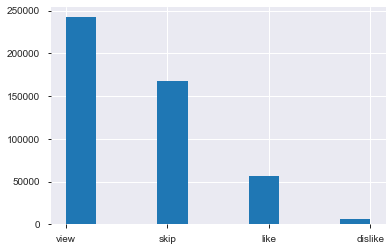

In [74]:
stories_r_train_df['event'].hist()

## Get y vector for target

In [75]:
y = stories_r_train_df['event'].map({'dislike': 0, 'skip': 1, 'view': 2, 'like': 3, })

In [76]:
y.value_counts()

2    242312
1    167567
3     56687
0      6575
Name: event, dtype: int64

In [77]:
X_train, X_val, y_train, y_val = train_test_split(train_df, y, test_size=0.22, random_state=17, stratify=y)

In [78]:
cat = X_train.select_dtypes(include=['category']).columns.tolist()

## Good params

In [79]:
params = {'bagging_fraction': 0.7, 'boosting_type': 'gbdt', 'early_stopping_rounds': 7, 
          'feature_fraction': 0.8, 'lambda_l1': 2.5, 'lambda_l2': 5.5, 'learning_rate': 0.2, 'max_bin': 250, 
          'max_depth': -1, 'metric': {'multi_logloss'}, 'min_child_weight': 0.05, 'min_data_in_leaf': 600, 
          'nthread': 8, 'num_leaves': 100, 'objective': 'multiclass', 'silent': 1, 'num_class' : 4,}

# 6. Train LightGBM

In [80]:
train_ds = lgb.Dataset(X_train, label=y_train, categorical_feature=cat, )
val_ds = lgb.Dataset(X_val, label=y_val, categorical_feature=cat, reference=train_ds)

In [81]:
%%time
booster = lgb.train(params, train_ds, num_boost_round=10000, valid_sets=[train_ds, val_ds], valid_names=['train', 'valid'], verbose_eval=100, categorical_feature=cat, early_stopping_rounds=10)

Training until validation scores don't improve for 7 rounds.
[100]	train's multi_logloss: 0.729648	valid's multi_logloss: 0.795447
[200]	train's multi_logloss: 0.659707	valid's multi_logloss: 0.777368
[300]	train's multi_logloss: 0.607828	valid's multi_logloss: 0.769691
[400]	train's multi_logloss: 0.564604	valid's multi_logloss: 0.766622
Early stopping, best iteration is:
[460]	train's multi_logloss: 0.542146	valid's multi_logloss: 0.765952
Wall time: 17min 20s


In [82]:
y_pred = booster.predict(test_df)

#### Predict sample

In [83]:
y_pred[:5]

array([[3.07162365e-05, 4.47755646e-01, 5.48376818e-01, 3.83681965e-03],
       [1.12588250e-04, 5.04466529e-01, 4.90418447e-01, 5.00243482e-03],
       [1.10928787e-03, 4.77977047e-01, 5.13230029e-01, 7.68363583e-03],
       [1.00649937e-04, 1.10545192e-01, 8.88813355e-01, 5.40803451e-04],
       [1.67099922e-04, 4.78321480e-01, 5.20394033e-01, 1.11738782e-03]])

In [84]:
pred = pd.DataFrame(y_pred*(-10, -0.1, 0.1, 0.5))
pred['sum_score'] = pred.sum(axis=1)
pred['final_score'] = np.where(pred['sum_score']>=0, 1, -1)

In [85]:
sample_submission['score'] = pred['final_score']
sample_submission.to_csv('sub_final.csv', index=False)

# 7. Feature importance

## By gain

In [86]:
pd.DataFrame(list(zip(booster.feature_name(), booster.feature_importance(importance_type='gain')))).sort_values(1, ascending=False).head(50)

,0,1
777,log_st_us,42052.516890
3,event_dttm_day_month_2,30365.706633
1,story_id,20748.408110
778,stcnt_trmed_allpr,15845.527745
361,tran_pca6,14278.618886
786,cst_st_descr,13880.516764
17,age,13873.448992
359,tran_pca4,13244.530042
363,tran_pca8,12951.157873
0,customer_id,12805.306751


## By shap

In [89]:
shap_values = shap.TreeExplainer(booster).shap_values(X_val)

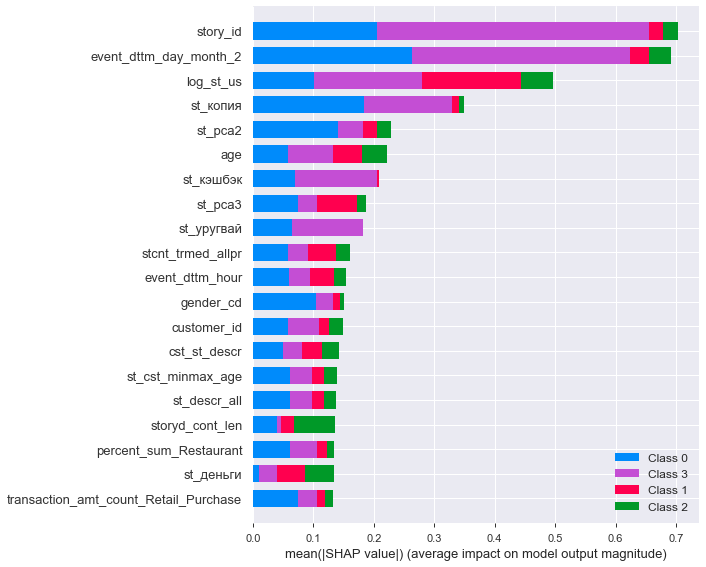

In [90]:
shap.summary_plot(shap_values, X_val)

In [96]:
len(shap_values[0][0])

787

In [112]:
shap_importance = pd.DataFrame(list(zip(X_val.columns, np.mean(np.mean(shap_values, axis=0), axis=0))), columns=['column', 'shap_value'])
shap_importance.sort_values(by=['shap_value'], ascending=False).head(50)

,column,shap_value
786,cst_st_descr,0.004255
1,story_id,0.004046
261,transaction_amt_count_Food_Stores,0.003557
357,tran_pca2,0.003106
330,transaction_amt_count,0.002853
781,days2_retails,0.002535
748,st_pca3,0.002394
362,tran_pca7,0.002118
335,transaction_amt_sum,0.002012
777,log_st_us,0.001935
